In [1]:
from assignment_utils import *

%load_ext autoreload
%autoreload 2

# Assignments 2


## Exercise 1
Consider the model:

$$p(x|\theta)\propto \frac{1}{\sqrt{2\pi}}\exp(-\frac{(x_1-\theta)^2+(x_2-\theta)^2}{2})$$

Find a Laplace approximation for this model, as seen for the Binomal model, and plot the resulting Gaussian approximation. Can you relate this model to the posterior of the mean of a Gaussian as seen in class (Lesson 3)?

___
### Find Laplace approximation

Let $f$ be defined as follows:
$$
p(x|\theta)\propto \frac{1}{\sqrt{2\pi}}\exp(-\frac{(x_1-\theta)^2+(x_2-\theta)^2}{2})
$$
We define $g$ to be the function satisfying:
$$
f(x) = \exp(\log(f(x))) = \exp(g(\theta))
$$
From the Taylor expansion in a maximum of both $f$ and $g$ in $\theta = \theta_0$, we get:
\begin{align*}
\begin{cases}
g(\theta) = g(\theta_0) + g'(\theta_0)(\theta-\theta_0) + \frac{1}{2}g''(\theta_0)(\theta-\theta_0)^2 + O((\theta - \theta_0)^3)\\
g'(\theta_0) = 0 \\
\end{cases}
\end{align*}
Therefore:
\begin{align*}
g(\theta) &\approx g(\theta_0) + \frac{1}{2}g''(\theta_0)(\theta-\theta_0)^2 \\
f(\theta) &\approx f(\theta_0) \exp\left[\frac{1}{2}g''(\theta_0)(\theta-\theta_0)^2\right]
\end{align*}
We recognize that the last term is the PDF of a Normal distribution:
$$
\mathcal{N}\left(\theta_0, \frac{-1}{g''(\theta_0)}\right)
$$
We find the maximum of the function by computing the derivative with respect to $\theta$ and equating to 0. We compute the derivative:
\begin{align*}
\frac{\partial}{\partial \theta} g(\theta)
&= \frac{\partial}{\partial \theta} \log f(\theta) \\
&= \frac{\partial}{\partial \theta} \left[ \left( \log \frac{1}{\sqrt{2\pi}} \right) -\frac{(x_1-\theta)^2+(x_2-\theta)^2}{2} \right] \\
&= -\frac{-2(x_1-\theta)-2(x_2-\theta)}{2} \\
&= x_1+x_2-2\theta \\
\end{align*}
Now wet equate to 0:
\begin{align*}
&\frac{\partial}{\partial \theta} g(\theta_0) = 0 \\
\implies&
x_1+x_2-2\theta_0 = 0 \\
\implies&
\theta_0 = \frac{x_1 + x_2}{2} \\
\end{align*}
This gives us the mean of the normal distribution:
$$
\mu := \theta_0 = \frac{x_1 + x_2}{2}
$$

Now to get the variance, we compute the second derivative fo $g$:
$$
\frac{\delta^2 g}{\delta \theta^2} (\theta) = - 2
$$
and we evaluate it in $\theta_0$:
\begin{align*}
\frac{\delta^2 g}{\delta \theta^2} (\theta_0)
&= - 2 \\
\end{align*}
but $\frac{\delta^2 g}{\delta \theta^2}$ doesn't depend on $\theta$. Finally, the variance is given by:
\begin{align*}
&
\sigma^2 = \left[-\frac{\delta^2 g}{\delta \theta^2} (\theta_0)\right]^{-1} \\
 \\
\implies &
\sigma^2 = \frac{1}{2}
\end{align*}
Hence the Gaussian approximation is given by:
$$
\mathcal{N}(\mu, \sigma^2)
$$
with $\mu$ and $\sigma$ defined previously.

### Plot ground truth vs Laplace approximation

In [2]:
plot_model_vs_laplace(x1=0.3, x2=0.7)

### Relate with the posterior for the mean of a normal distribution
Lesson 3 tells us that the posterior for the mean of a normal distribution is proportional to:
$$
(1) \iff p(\theta | y) \sim \exp[-\frac{1}{2\sigma^2}(y-\theta)^2 - \frac{1}{2\tau_0^2}(\theta-\mu_0)^2]
$$
We want to relate this to our model:
$$
(2) \iff p(x|\theta) \propto \frac{1}{\sqrt{2\pi}}\exp(-\frac{(x_1-\theta)^2+(x_2-\theta)^2}{2})
$$
Setting $\tau_0 = \sigma^2 = 1$ in $(1)$ and $x_1 = y, x_2 = \mu_0$ in $(2)$, we get:
\begin{align*}
p(\theta | y) 
&\sim \exp[-\frac{1}{2\sigma^2}(y-\theta)^2 - \frac{1}{2\tau_0^2}(\theta-\mu_0)^2] \\
&= \exp[-\frac{(y-\theta)^2 -(\theta-\mu_0)^2}{2}] \\
&= \exp[-\frac{(x_1-\theta)^2 -(\theta-x_2)^2}{2}] \\
&\propto \frac{1}{\sqrt{2\pi}} \exp[-\frac{(x_1-\theta)^2 -(x_2-\theta)^2}{2}] \\
&\propto p(x|\theta) \\
\end{align*}
Thus we see that the two quantities at hand are proportional, and therefore related.

## Exercise 2
Write down a model to evaluate the claim: *Animal diversity is related to latitude, but only after controlling for plant diversity*. You just need to write down the model definition.
___

Latitude represents the angle of how far north a point is situated. It is -90° at the south pole, 0° at the equator and 90° at the north pole.

One could easily assume that the further away from the equator (north pole, south pole), the most inhospitable the environment. On the other hand, the closer from the equator (tropical rainforest), the most prolific the environment, *i.e.* high animal diversity.

One could also assume that the model has some symmetry built into it as we see similar behaviors when latitude increases both positively or negatively.

Finally, we can assume that animal and plant diversity are positively. This seems as a natural assumption.

In order to measure animal diversity, one would need to find an appropriate metric. Maybe something like the number of animal species per $km^2$.

We expect the plant diversity as a function of latitude to look something like the plot below:

In [3]:
possible_animal_diversity_model()

Given the discussion above, we want to study the relationship between animal diversity and latitude, as well as controlling plant diversity. Rephrasing, we want to study the animal diversity **given** latitude **and** plant diversity.

Let:
- $A$ be the animal diversity
- $L$ be the latitude
- $P$ be the plant diversity

We can rewrite such a model as a regression function $f$ of a linear model:
$$
f \to \mathbb{E}[A \mid L, P]
$$
Then our linear model would be:
$$
A = \alpha + \beta L + \gamma P
$$
with:
- $\alpha$ the intercept
- $\beta$ the coefficient for latitude
- $\gamma$ the coefficient for plant diversity


## Exercise 3
The attached data is about observations of urban foxes in human habitat. The data has 5 columns:

- *group*: Number of social group the fox belongs to
- *avgfood*: The avg amount of food available in the territory
- *groupsize*: The number of foxes in the social group
- *area*: Size of the territory
- *weight*: Body weight of the fox

Fit a regression for *weight* as a linear function of *area*, and a regression for *weight* as a linear function of *groupsize*. What can you say about these relationships? Run a multivariate model with both variables, what can you conclude about this analysis?

In [4]:
fox = pd.read_csv("data.csv")
fox

,group,avgfood,groupsize,area,weight
0,1,0.37,2,1.09,5.02
1,1,0.37,2,1.09,2.84
2,2,0.53,2,2.05,5.33
3,2,0.53,2,2.05,6.07
4,3,0.49,2,2.12,5.85
...,...,...,...,...,...
111,29,0.67,4,2.75,4.81
112,29,0.67,4,2.75,3.94
113,30,0.41,3,1.91,3.16
114,30,0.41,3,1.91,2.78


In [5]:
plot_fox_col_distr(col="weight")

In [6]:
plot_fox_col_distr(col="area")

In [7]:
plot_fox_col_distr(col="groupsize")

In [8]:
plot_dependent_var_vs_covariates()

Remarks:
- All three distributions (weight, area, groupsize) have a bump to the right side of the plot, although some more noticeable than others
- Beside the slight bump, the weight distribution looks somewhat close to a normal distribution
- There is no clear correlation between the weights and any of the potential covariates

### Make a base model of `weight` from its mean and variance

We may consider that the weight of foxes are independent random variables. As such, we have that the probability of their intersection is the product of their respective probabilities:
\begin{align*}
\mathbb{P}(weight)
&= \mathbb{P}(weight_1, \ldots, weight_n) \\
&= \mathbb{P}(weight_1) \ldots \mathbb{P}(weight_n) \\
\end{align*}
where one could reasonably assume that the weight of a given fox is normally distributed $\mathcal{N}(\mu, \sigma^2)$.

In [9]:
mean_weight = fox["weight"].mean()
print(f"The mean of the fox weights is: {mean_weight}")

The mean of the fox weights is: 4.529655172413793


We choose 
\begin{align*}
\mu_{prior} &\sim \mathcal{N}(4.5, 2) \\
\sigma_{prior} &\sim \mathcal{U}(0, 2)
\end{align*}
where:
- $\mu_{prior}$ is centered in 4.5 because this is the mean of the weights
- $\mu_{prior}$ has variance 2 (standard deviation $\sqrt{2} \approx 1.4$) because this gives a $2\sigma$ interval of $[1.7, 7.3]$. Such an interval contains almost all of our data, so it seems far from being too restrictive
- $\sigma_{prior}$ is an uninformative estimate of the variance because we do not have much insight to give on this parameter

Let $y$ be the weight of foxes. Then our likelihood is given by:
$$
\mathbb{P}(y \mid \mu, \sigma^2) = \mathcal{N}(y \mid \mu, \sigma^2)
$$

In [10]:
n_samples = 1000
_ = compute_posterior_samples_stats(n_samples=n_samples, param_names=["mu", "sigma"])


------------ Output of Laplace computation ------------
      fun: 185.99448612478704
 hess_inv: array([[ 1.19528884e-02, -1.52933234e-06],
       [-1.52933234e-06,  5.99496731e-03]])
      jac: array([ 0.00000000e+00, -3.81469727e-06])
  message: 'Optimization terminated successfully.'
     nfev: 30
      nit: 5
     njev: 10
   status: 0
  success: True
        x: array([4.52956663, 1.17890794])


 ------------ Stats on Laplace computation ------------


,mean,std,10%,90%
mu,4.524753,0.110287,4.349137,4.705418
sigma,1.176655,0.076112,1.051166,1.305401


We will use these estimates for the mean and standard deviation of $\mu$ in the following models.

### Make a regression of `weight` as a linear function of `area`
This model is represented by the following formula:
$$
weight = \alpha + \beta * area
$$
In particular, we assume in this section that the weight of a fox is related (dependent) to the `area` variable. This could be justified by a base weight of $\alpha$ for a fox with $area = 0$ and an increase of $\beta$ kg for each extra $km^2$ of territory (for instance, assuming that more territory means more hunting surface, which means increased weight).\
Let:
$$
\mu_i = \alpha + \beta * area_i
$$
Then, we assume that the `weight` variable follows a Gaussian distribution, that is:
$$
weight_i \sim \mathcal{N}(\mu_i, \sigma^2)
$$
Note that we assume that the mean depends on $\alpha$, $\beta$ and the `area`, but that the variance of the data is the same for all foxes.

We now define our priors:
\begin{align*}
\mathbb{P}(\alpha) &= \mathcal{N}(4.5, 0.11) \\
\mathbb{P}(\beta) &= \mathcal{N}(0, 1) \\
\mathbb{P}(\sigma) &= \mathcal{U}(4.5, 2) \\
\end{align*}
where $\mathbb{P}(\alpha)$ is deduced from what we found in the previous section. $\mathbb{P}(\beta)$ and $\mathbb{P}(\sigma)$ are simply fairly uninformative, but accounting for the domain of the random variable, guesses. Had the plots drawn before been more informative, we may have been able to guess more precisely, but this is not the case here.

We want to perform Laplace approximation, but we will center the data before that. This is meant to prevent shift issues.

In [11]:
plot_samples_from_posterior(col="area")

------------ Output of Laplace computation ------------
      fun: 184.00945230951896
 hess_inv: array([[ 6.03485153e-03, -1.43610523e-05, -4.82042082e-05],
       [-1.43610523e-05,  1.37829017e-02,  7.55810043e-06],
       [-4.82042082e-05,  7.55810043e-06,  6.01765969e-03]])
      jac: array([-3.81469727e-06,  0.00000000e+00, -1.90734863e-06])
  message: 'Optimization terminated successfully.'
     nfev: 44
      nit: 7
     njev: 11
   status: 0
  success: True
        x: array([4.51490233, 0.02449787, 1.1787767 ])


 ------------ Stats on Laplace computation ------------


,mean,std,10%,90%
alpha,4.510864,0.077127,4.390057,4.638914
beta,0.030261,0.115871,-0.162888,0.212389
sigma,1.180921,0.079782,1.040839,1.310046


[ 4.41878445 -0.03404395  1.19507707]


In [12]:
col = "area"
post_means, post_stds, post_samples = compute_posterior_samples_stats(
    n_samples=n_samples, var_used=[col], param_names=["alpha", "beta", "sigma"]
  )

------------ Output of Laplace computation ------------
      fun: 184.00945230951908
 hess_inv: array([[ 6.31577031e-03,  4.05651854e-06, -1.06536126e-04],
       [ 4.05651854e-06,  1.50821719e-02,  2.44429440e-05],
       [-1.06536126e-04,  2.44429440e-05,  6.00131926e-03]])
      jac: array([ 1.90734863e-06,  5.72204590e-06, -1.90734863e-06])
  message: 'Optimization terminated successfully.'
     nfev: 52
      nit: 9
     njev: 13
   status: 0
  success: True
        x: array([4.51490236, 0.02449793, 1.17877668])


 ------------ Stats on Laplace computation ------------


,mean,std,10%,90%
alpha,4.518106,0.079761,4.388686,4.647904
beta,0.025870,0.120595,-0.173743,0.216050
sigma,1.180331,0.076440,1.051365,1.304558


[]

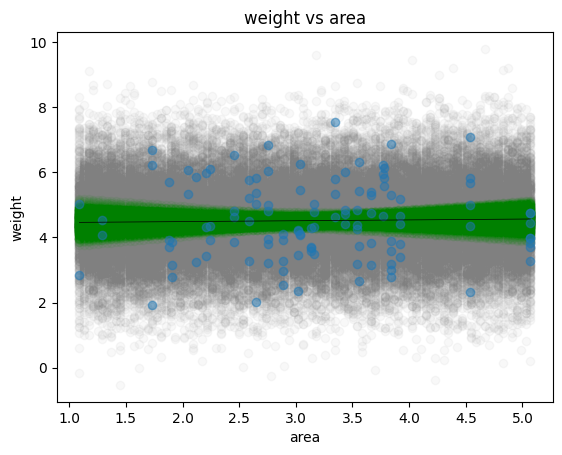

In [13]:
fox[f"centered_{col}"] = fox[col] - fox[col].mean()
x_min = fox[f"centered_{col}"].min()
x_max = fox[f"centered_{col}"].max()
x_range = np.linspace(start=x_min, stop=x_max, num=100)


prediction_range = []
# sampling from the posterior to get a predictive interval
for x_ in x_range:
  prediction_range.append(post_samples[:500, 0] + post_samples[:500, 1] * x_)

prediction_range_noise = []

# sampling from the posterior to get a predictive interval
for x_ in x_range:
  prediction_range_noise.append(
    norm.rvs(post_samples[:500, 0] + post_samples[:500, 1] * x_, post_samples[:500, 2])
  )

# Plotting the uncertainty
for i, x_ in enumerate(x_range):
  plt.scatter(
    np.repeat(x_, 500) + fox[col].mean(),
    prediction_range_noise[i],
    alpha=0.05,
    color="grey",
  )
for i, x_ in enumerate(x_range):
  plt.scatter(
    np.repeat(x_, 500) + fox[col].mean(),
    prediction_range[i],
    alpha=0.05,
    color="green",
  )


plt.scatter(fox["area"], fox["weight"], alpha=0.5)
plt.plot(
  x_range + fox[col].mean(), post_means[0] + post_means[1] * x_range, lw=0.5, color="black"
)
plt.title("weight vs area")
plt.ylabel("weight")
plt.xlabel("area")
plt.plot()


#### Remarks
We note that `area` seems to have very little influence on `weight`, as we had previously suspected.

### Make a regression of `weight` as a linear function of `groupsize`
As before, we center the `groupsize`.

In [14]:
plot_samples_from_posterior(col="groupsize")

------------ Output of Laplace computation ------------


/home/joris/.local/lib/python3.10/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning:

invalid value encountered in subtract



      fun: 182.5159011771248
 hess_inv: array([[ 5.33750680e-03, -4.09884032e-05, -7.77628952e-05],
       [-4.09884032e-05,  4.96250707e-03,  5.02604233e-05],
       [-7.77628952e-05,  5.02604233e-05,  5.77560478e-03]])
      jac: array([1.90734863e-06, 3.81469727e-06, 5.72204590e-06])
  message: 'Optimization terminated successfully.'
     nfev: 114
      nit: 22
     njev: 27
   status: 0
  success: True
        x: array([ 4.51509421, -0.12328591,  1.16362112])


 ------------ Stats on Laplace computation ------------


,mean,std,10%,90%
alpha,4.512972,0.073982,4.391499,4.629587
beta,-0.123515,0.069503,-0.239422,-0.012132
sigma,1.163225,0.075273,1.040890,1.287306


[ 4.58971353 -0.16812646  1.33741855]


In [15]:
col = "groupsize"
post_means, post_stds, post_samples = compute_posterior_samples_stats(
    n_samples=n_samples, var_used=[col], param_names=["alpha", "beta", "sigma"]
  )

------------ Output of Laplace computation ------------


/home/joris/.local/lib/python3.10/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning:

invalid value encountered in subtract



      fun: 182.51590117712476
 hess_inv: array([[ 6.01256834e-03,  1.09147639e-04, -7.11770650e-05],
       [ 1.09147639e-04,  5.13852724e-03, -2.52039421e-05],
       [-7.11770650e-05, -2.52039421e-05,  5.88624553e-03]])
      jac: array([1.90734863e-06, 3.81469727e-06, 3.81469727e-06])
  message: 'Optimization terminated successfully.'
     nfev: 84
      nit: 13
     njev: 20
   status: 0
  success: True
        x: array([ 4.51509419, -0.12328592,  1.16362111])


 ------------ Stats on Laplace computation ------------


,mean,std,10%,90%
alpha,4.513002,0.080567,4.386084,4.649654
beta,-0.126823,0.073527,-0.246157,-0.003885
sigma,1.163844,0.079026,1.029507,1.291151


[]

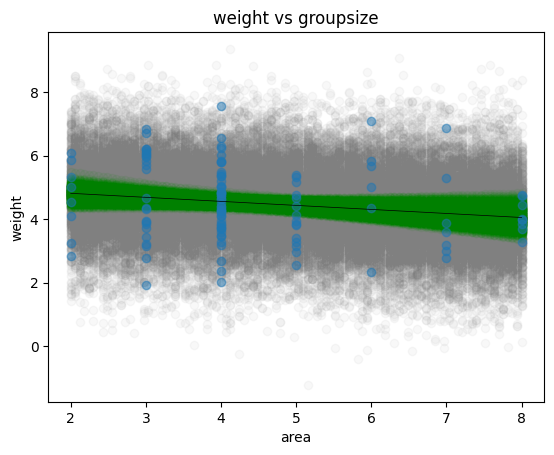

In [16]:
fox[f"centered_{col}"] = fox[col] - fox[col].mean()
x_min = fox[f"centered_{col}"].min()
x_max = fox[f"centered_{col}"].max()
x_range = np.linspace(start=x_min, stop=x_max, num=100)


prediction_range = []
# sampling from the posterior to get a predictive interval
for x_ in x_range:
  prediction_range.append(post_samples[:500, 0] + post_samples[:500, 1] * x_)

prediction_range_noise = []

# sampling from the posterior to get a predictive interval
for x_ in x_range:
  prediction_range_noise.append(
    norm.rvs(post_samples[:500, 0] + post_samples[:500, 1] * x_, post_samples[:500, 2])
  )

# Plotting the uncertainty
for i, x_ in enumerate(x_range):
  plt.scatter(
    np.repeat(x_, 500) + fox[col].mean(),
    prediction_range_noise[i],
    alpha=0.05,
    color="grey",
  )
for i, x_ in enumerate(x_range):
  plt.scatter(
    np.repeat(x_, 500) + fox[col].mean(),
    prediction_range[i],
    alpha=0.05,
    color="green",
  )


plt.scatter(fox[col], fox["weight"], alpha=0.5)
plt.plot(
  x_range + fox[col].mean(), post_means[0] + post_means[1] * x_range, lw=0.5, color="black"
)
plt.title(f"weight vs {col}")
plt.ylabel("weight")
plt.xlabel("area")
plt.plot()


#### Remarks
The `weight` seems to slightly decrease as the `groupsize` increases, but as for the `area` previously, the relationship is very minor.

### Make a regression of `weight` as a linear function of `area` and `groupsize`



In [17]:
plot_samples_from_posterior(col="groupsize", var_used=["area", "groupsize"])

------------ Output of Laplace computation ------------


/home/joris/.local/lib/python3.10/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning:

invalid value encountered in subtract



      fun: 179.11521394796287
 hess_inv: array([[ 5.23427179e-03, -5.17631489e-05,  6.24482451e-05,
        -6.86487299e-05],
       [-5.17631489e-05,  3.32637409e-02, -1.63045712e-02,
        -2.84115693e-04],
       [ 6.24482451e-05, -1.63045712e-02,  1.25583385e-02,
         1.54148941e-04],
       [-6.86487299e-05, -2.84115693e-04,  1.54148941e-04,
         5.28520470e-03]])
      jac: array([1.90734863e-06, 0.00000000e+00, 0.00000000e+00, 1.90734863e-06])
  message: 'Optimization terminated successfully.'
     nfev: 157
      nit: 25
     njev: 30
   status: 0
  success: True
        x: array([ 4.51567755,  0.58635658, -0.41480651,  1.1186629 ])


 ------------ Stats on Laplace computation ------------


,mean,std,10%,90%
alpha,4.513120,0.071539,4.396575,4.635390
beta,0.577917,0.175534,0.278830,0.872849
beta2,-0.413211,0.106850,-0.590363,-0.238453
sigma,1.119259,0.070776,1.003619,1.237931


[ 4.45250068  0.35508739 -0.18899949  1.20190687]


In [18]:
cols = ["area", "groupsize"]
post_means, post_stds, post_samples = compute_posterior_samples_stats(
    n_samples=n_samples, var_used=cols, param_names=["alpha", "beta", "beta2", "sigma"]
  )

------------ Output of Laplace computation ------------


/home/joris/.local/lib/python3.10/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning:

invalid value encountered in subtract



      fun: 179.11521394796284
 hess_inv: array([[ 5.78669122e-03, -8.20841123e-07,  1.04669174e-05,
        -7.04228829e-05],
       [-8.20841123e-07,  3.95792001e-02, -1.96458129e-02,
        -2.75923868e-04],
       [ 1.04669174e-05, -1.96458129e-02,  1.43317447e-02,
         1.40276496e-04],
       [-7.04228829e-05, -2.75923868e-04,  1.40276496e-04,
         5.43736701e-03]])
      jac: array([1.90734863e-06, 0.00000000e+00, 1.90734863e-06, 0.00000000e+00])
  message: 'Optimization terminated successfully.'
     nfev: 101
      nit: 13
     njev: 19
   status: 0
  success: True
        x: array([ 4.51567754,  0.58635652, -0.41480649,  1.11866291])


 ------------ Stats on Laplace computation ------------


,mean,std,10%,90%
alpha,4.515042,0.076594,4.384797,4.638233
beta,0.589247,0.197411,0.263470,0.908682
beta2,-0.416491,0.117341,-0.606294,-0.221286
sigma,1.119822,0.073565,0.996747,1.232908


[]

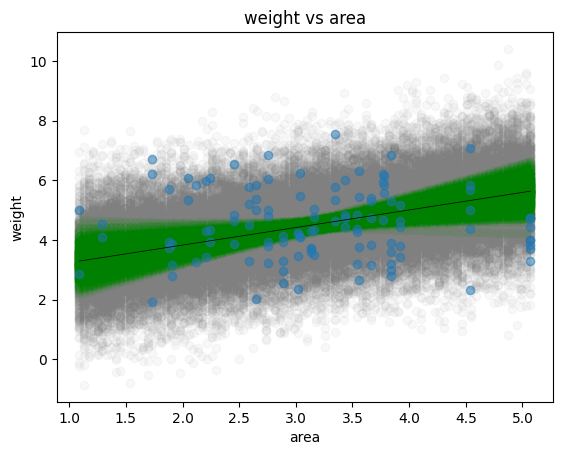

In [19]:
col = cols[0]
fox[f"centered_{col}"] = fox[col] - fox[col].mean()
x_min = fox[f"centered_{col}"].min()
x_max = fox[f"centered_{col}"].max()
x_range = np.linspace(start=x_min, stop=x_max, num=100)


prediction_range = []
# sampling from the posterior to get a predictive interval
for x_ in x_range:
  prediction_range.append(post_samples[:500, 0] + post_samples[:500, 1] * x_)

prediction_range_noise = []

# sampling from the posterior to get a predictive interval
for x_ in x_range:
  prediction_range_noise.append(
    norm.rvs(post_samples[:500, 0] + post_samples[:500, 1] * x_, post_samples[:500, -1])
  )

# Plotting the uncertainty
for i, x_ in enumerate(x_range):
  plt.scatter(
    np.repeat(x_, 500) + fox[col].mean(),
    prediction_range_noise[i],
    alpha=0.05,
    color="grey",
  )
for i, x_ in enumerate(x_range):
  plt.scatter(
    np.repeat(x_, 500) + fox[col].mean(),
    prediction_range[i],
    alpha=0.05,
    color="green",
  )


plt.scatter(fox[col], fox["weight"], alpha=0.5)
plt.plot(
  x_range + fox[col].mean(), post_means[0] + post_means[1] * x_range, lw=0.5, color="black"
)
plt.title(f"weight vs {col}")
plt.ylabel("weight")
plt.xlabel(col)
plt.plot()


[]

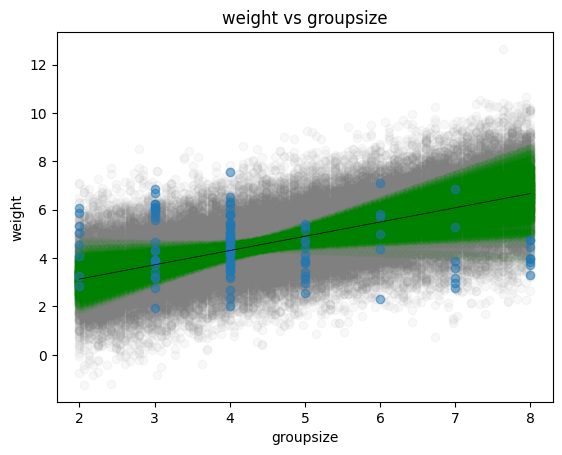

In [20]:
col = cols[1]
fox[f"centered_{col}"] = fox[col] - fox[col].mean()
x_min = fox[f"centered_{col}"].min()
x_max = fox[f"centered_{col}"].max()
x_range = np.linspace(start=x_min, stop=x_max, num=100)


prediction_range = []
# sampling from the posterior to get a predictive interval
for x_ in x_range:
  prediction_range.append(post_samples[:500, 0] + post_samples[:500, 1] * x_)

prediction_range_noise = []

# sampling from the posterior to get a predictive interval
for x_ in x_range:
  prediction_range_noise.append(
    norm.rvs(post_samples[:500, 0] + post_samples[:500, 1] * x_, post_samples[:500, -1])
  )

# Plotting the uncertainty
for i, x_ in enumerate(x_range):
  plt.scatter(
    np.repeat(x_, 500) + fox[col].mean(),
    prediction_range_noise[i],
    alpha=0.05,
    color="grey",
  )
for i, x_ in enumerate(x_range):
  plt.scatter(
    np.repeat(x_, 500) + fox[col].mean(),
    prediction_range[i],
    alpha=0.05,
    color="green",
  )


plt.scatter(fox[col], fox["weight"], alpha=0.5)
plt.plot(
  x_range + fox[col].mean(), post_means[0] + post_means[1] * x_range, lw=0.5, color="black"
)
plt.title(f"weight vs {col}")
plt.ylabel("weight")
plt.xlabel(col)
plt.plot()


#### Remarks
We see that the model is able to better quantify its uncertainty through variance of its predictions.

### Conclusion
We saw that when using only `area` or only `groupsize`, the model is not able to grasp the variance in the data. When we combine both variables however, the model is able to tell us when it is unsure about its predictions. This is what we want from a model. If the model cannot predict correctly (*e.g.* because of too little data points), we want to know that the model is unsure. We see that in this case, the edge cases (where little data is available) do indeed show greater uncertainty.

The model was also able to be more assertive about linear dependencies. Indeed, in the first univariate case, the `area` is only slightly negatively correlated with the `weight` (if at all). Similarly, in the second univariate case, the `groupsize` is only slightly positively correlated to the `weight`. In the multivariate case however, we see both trends strengthen, as well as providing greater values for uncertainty.

## Exercise 4
Consider the diabetes dataset

In [21]:
from sklearn import datasets 
import numpy as np
import matplotlib.pyplot as plt

dataset = datasets.load_diabetes(return_X_y=False)
print(dataset.DESCR)

.. _diabetes_dataset:

Diabetes dataset
----------------

Ten baseline variables, age, sex, body mass index, average blood
pressure, and six blood serum measurements were obtained for each of n =
442 diabetes patients, as well as the response of interest, a
quantitative measure of disease progression one year after baseline.

**Data Set Characteristics:**

  :Number of Instances: 442

  :Number of Attributes: First 10 columns are numeric predictive values

  :Target: Column 11 is a quantitative measure of disease progression one year after baseline

  :Attribute Information:
      - age     age in years
      - sex
      - bmi     body mass index
      - bp      average blood pressure
      - s1      tc, total serum cholesterol
      - s2      ldl, low-density lipoproteins
      - s3      hdl, high-density lipoproteins
      - s4      tch, total cholesterol / HDL
      - s5      ltg, possibly log of serum triglycerides level
      - s6      glu, blood sugar level

Note: Each of these 1

In [22]:
# Define the feature matrix
data = dataset.data
# Define the target
target = dataset.target

Investigate the relationship between age (data[:,0]) and Average blood pressure (data[:,3]) with a linear and quadratic model. 

- Which model do you think is better? 
- Predict a 95% confidence interval for the average blood pressure on an individual with mean age (0). 



In [23]:
diab = pd.DataFrame(data = data, columns = dataset.feature_names)
diab = diab[["age", "bp"]]
diab

,age,bp
0,0.038076,0.021872
1,-0.001882,-0.026328
2,0.085299,-0.005670
3,-0.089063,-0.036656
4,0.005383,0.021872
...,...,...
437,0.041708,0.059744
438,-0.005515,-0.067642
439,0.041708,0.017293
440,-0.045472,0.001215


In [24]:
fig = ff.create_distplot(hist_data=[diab["age"]], group_labels=["age"])
fig.update_xaxes(range=[-0.15, 0.15])

In [25]:
fig = ff.create_distplot(hist_data=[diab["bp"]], group_labels=["bp"])
fig.update_xaxes(range=[-0.15, 0.15])

In [26]:
px.scatter(diab, "age", "bp", trendline="ols")

### Some observations
We see that plotting a dummy ols trendline (provided by the Plotly package) certifies the intuition one could have that there is a slight positive correlation between `age` and `bp`.

Also, we see that the variables are centered and scaled, as indicated in the description of the dataset provided above.

We now want to perform a statistical analysis of the relationship between `age` and `bp`. As such, we want to study the following relationship:
\begin{align*}
age &= \alpha + \beta * bp \\
age &\sim \mathcal{N}(\alpha + \beta * bp)
\end{align*}
Please note that $\alpha$ (the intercept) represents the `age` of a patient with $bp = 0$ (after the dataset was centered, hence mean `bp`).

### Linear model
We will investigate the linear model with:
\begin{align*}
\mathbb{P}(\alpha) &= \mathcal{N}(0, 1) \\
\mathbb{P}(\beta) &= \mathcal{N}(0, 1) \\
\mathbb{P}(\sigma) &= \mathcal{U}(0, 2)
\end{align*}
We assume a normal distribution for $\alpha$ because of the shape of the data and the fact that it is centered in 0. \
We assume a uniform distribution for the parameter $\sigma$ because we do not have much prior information to provide.

**Note:** The optimization process fails most of the time, even when changing the value of our priors.

In [27]:
expression = "age ~ bp"

# Initializing the likelihood
lik = "gaussian"

# Defining the prior with hyperparameters
prior_a_mean = 0
prior_a_sigma = 1
prior_a = ["gaussian", [prior_a_mean, prior_a_sigma]]

prior_b_mean = 0
prior_b_sigma = 1
prior_b = ["gaussian", [prior_b_mean, prior_b_sigma]]

prior_sigma_inf = 0
prior_sigma_sup = 2
prior_sigma = ["uniform", [prior_sigma_inf, prior_sigma_sup]]

# Performs the optimization
laplace_sol = laplace_solution_regression(
  expression=expression,
  data=diab,
  lik=lik,
  priors=[prior_a, prior_b, prior_sigma],
)
laplace_sol

      fun: -742.8000234074088
 hess_inv: array([[ 4.26966595e-06,  5.35657823e-06, -2.94376215e-08],
       [ 5.35657823e-06,  1.90714277e-03, -3.99834880e-07],
       [-2.94376215e-08, -3.99834880e-07,  2.22944852e-06]])
      jac: array([1.52587891e-05, 0.00000000e+00, 1.52587891e-05])
  message: 'Desired error not necessarily achieved due to precision loss.'
     nfev: 307
      nit: 29
     njev: 74
   status: 2
  success: False
        x: array([-7.34506345e-09,  3.34755437e-01,  4.48095137e-02])


[array([-7.34506345e-09,  3.34755437e-01,  4.48095137e-02]),
 array([[ 4.26966595e-06,  5.35657823e-06, -2.94376215e-08],
        [ 5.35657823e-06,  1.90714277e-03, -3.99834880e-07],
        [-2.94376215e-08, -3.99834880e-07,  2.22944852e-06]])]

In [34]:
post_samples = np.random.multivariate_normal(
    laplace_sol[0], laplace_sol[1], size=1000
  )
print(12 * "-", "Stats on Laplace computation", 12 * "-")

post_means = post_samples.mean(axis=0)
post_stds = post_samples.std(axis=0)
quantiles = np.quantile(a=post_samples, q=[0.05, 0.95], axis=0)

stats = [post_means, post_stds, quantiles[0, :], quantiles[1, :]]
stats = pd.DataFrame(stats, columns=["alpha", "beta", "sigma"], index=["mean", "std", "10%", "90%"])
stats = stats.transpose()
display(stats)

------------ Stats on Laplace computation ------------


,mean,std,10%,90%
alpha,-0.000025,0.002011,-0.003395,0.003353
beta,0.334711,0.042673,0.262527,0.403738
sigma,0.044774,0.001481,0.042411,0.047206


In [35]:
x_min = diab["age"].min()
x_max = diab["age"].max()
x_range = np.linspace(start=x_min, stop=x_max, num=100)

# Create fig
fig = go.Figure(layout=dict(showlegend=False))
fig = px.scatter(diab, x="age", y="bp")
fig.update_layout(showlegend=False)

# Iterate over samples andadd trace
for sample in post_samples:
  intercept, slope, *_ = sample
  sample_trace = go.Scatter(
    x=x_range,
    y=intercept + slope * x_range,
    opacity=0.07,
    marker=dict(color="grey"),
  )
  fig.add_trace(sample_trace)

# Add trace for the mean
intercept, slope, *_ = post_means
mean_trace = go.Scatter(
  x=x_range,
  y=intercept + slope * x_range,
  marker=dict(color="black"),
)
fig.add_trace(mean_trace)

fig

-2.462926362734427e-05 0.33471139626650714


[]

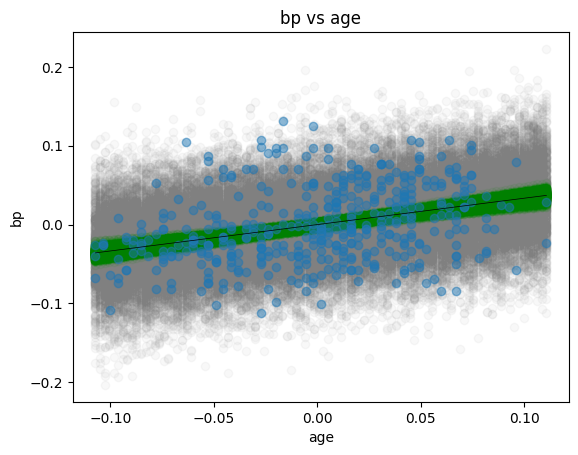

In [36]:
prediction_range = []
# sampling from the posterior to get a predictive interval
for x_ in x_range:
  prediction_range.append(post_samples[:500, 0] + post_samples[:500, 1] * x_)

prediction_range_noise = []

# sampling from the posterior to get a predictive interval
for x_ in x_range:
  prediction_range_noise.append(
    norm.rvs(post_samples[:500, 0] + post_samples[:500, 1] * x_, post_samples[:500, -1])
  )

# Plotting the uncertainty
for i, x_ in enumerate(x_range):
  plt.scatter(
    np.repeat(x_, 500) + diab["age"].mean(),
    prediction_range_noise[i],
    alpha=0.05,
    color="grey",
  )
for i, x_ in enumerate(x_range):
  plt.scatter(
    np.repeat(x_, 500) + diab["age"].mean(),
    prediction_range[i],
    alpha=0.05,
    color="green",
  )


plt.scatter(diab["age"], diab["bp"], alpha=0.5)
plt.plot(
  x_range + diab["age"].mean(), post_means[0] + post_means[1] * x_range, lw=0.5, color="black"
)
plt.title(f"bp vs age")
plt.ylabel("bp")
plt.xlabel("age")
plt.plot()


## Quadratic model
Similarly, we define our quadratic model

In [37]:
diab["bp2"] = diab["bp"]**2
diab

,age,bp,bp2
0,0.038076,0.021872,0.000478
1,-0.001882,-0.026328,0.000693
2,0.085299,-0.005670,0.000032
3,-0.089063,-0.036656,0.001344
4,0.005383,0.021872,0.000478
...,...,...,...
437,0.041708,0.059744,0.003569
438,-0.005515,-0.067642,0.004575
439,0.041708,0.017293,0.000299
440,-0.045472,0.001215,0.000001


In [46]:
expression = "age ~ bp + bp2"

# Initializing the likelihood
lik = "gaussian"

# Defining the prior with hyperparameters
prior_a_mean = 0
prior_a_sigma = 1
prior_a = ["gaussian", [prior_a_mean, prior_a_sigma]]

prior_b_mean = 0
prior_b_sigma = 1
prior_b = ["gaussian", [prior_b_mean, prior_b_sigma]]

prior_b2_mean = 0
prior_b2_sigma = 1
prior_b2 = ["gaussian", [prior_b2_mean, prior_b2_sigma]]

prior_sigma_inf = 0
prior_sigma_sup = 2
prior_sigma = ["uniform", [prior_sigma_inf, prior_sigma_sup]]

# Performs the optimization
laplace_sol = laplace_solution_regression(
  expression=expression,
  data=diab,
  lik=lik,
  priors=[prior_a, prior_b, prior_b2, prior_sigma],
)
laplace_sol

/home/joris/.local/lib/python3.10/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning:

invalid value encountered in subtract

/home/joris/.local/lib/python3.10/site-packages/scipy/optimize/_numdiff.py:576: RuntimeWarning:

invalid value encountered in subtract



      fun: -742.6202602970566
 hess_inv: array([[ 5.72046028e-06,  1.47266055e-06, -6.66328484e-04,
         2.83842872e-08],
       [ 1.47266055e-06,  8.31383501e-04, -1.56896485e-03,
         6.46178369e-07],
       [-6.66328484e-04, -1.56896485e-03,  3.41174552e-01,
        -2.03724641e-05],
       [ 2.83842872e-08,  6.46178369e-07, -2.03724641e-05,
         2.16606476e-06]])
      jac: array([ 1.52587891e-05,  0.00000000e+00,  0.00000000e+00, -7.62939453e-06])
  message: 'Desired error not necessarily achieved due to precision loss.'
     nfev: 273
      nit: 34
     njev: 53
   status: 2
  success: False
        x: array([ 0.00172287,  0.34522998, -0.76151702,  0.04470494])


[array([ 0.00172287,  0.34522998, -0.76151702,  0.04470494]),
 array([[ 5.72046028e-06,  1.47266055e-06, -6.66328484e-04,
          2.83842872e-08],
        [ 1.47266055e-06,  8.31383501e-04, -1.56896485e-03,
          6.46178369e-07],
        [-6.66328484e-04, -1.56896485e-03,  3.41174552e-01,
         -2.03724641e-05],
        [ 2.83842872e-08,  6.46178369e-07, -2.03724641e-05,
          2.16606476e-06]])]

In [48]:
post_samples = np.random.multivariate_normal(
    laplace_sol[0], laplace_sol[1], size=1000
  )
print(12 * "-", "Stats on Laplace computation", 12 * "-")

post_means = post_samples.mean(axis=0)
post_stds = post_samples.std(axis=0)
quantiles = np.quantile(a=post_samples, q=[0.05, 0.95], axis=0)

stats = [post_means, post_stds, quantiles[0, :], quantiles[1, :]]
stats = pd.DataFrame(stats, columns=["alpha", "beta", "beta2", "sigma"], index=["mean", "std", "10%", "90%"])
stats = stats.transpose()
display(stats)

------------ Stats on Laplace computation ------------


,mean,std,10%,90%
alpha,0.001778,0.002372,-0.001892,0.005773
beta,0.344253,0.028748,0.297124,0.392469
beta2,-0.778411,0.564232,-1.732242,0.114170
sigma,0.044657,0.001443,0.042256,0.047076


In [51]:
x_min = diab["age"].min()
x_max = diab["age"].max()
x_range = np.linspace(start=x_min, stop=x_max, num=100)

# Create fig
fig = go.Figure(layout=dict(showlegend=False))
fig = px.scatter(diab, x="age", y="bp2")
fig.update_layout(showlegend=False)

# Iterate over samples andadd trace
for sample in post_samples:
  intercept, slope, slope2, *_ = sample
  sample_trace = go.Scatter(
    x=x_range,
    y=intercept + slope * x_range + slope * x_range**2,
    opacity=0.07,
    marker=dict(color="grey"),
  )
  fig.add_trace(sample_trace)

# Add trace for the mean
intercept, slope, *_ = post_means
mean_trace = go.Scatter(
  x=x_range,
  y=intercept + slope * x_range + slope * x_range**2,
  marker=dict(color="black"),
)
fig.add_trace(mean_trace)

fig


[]

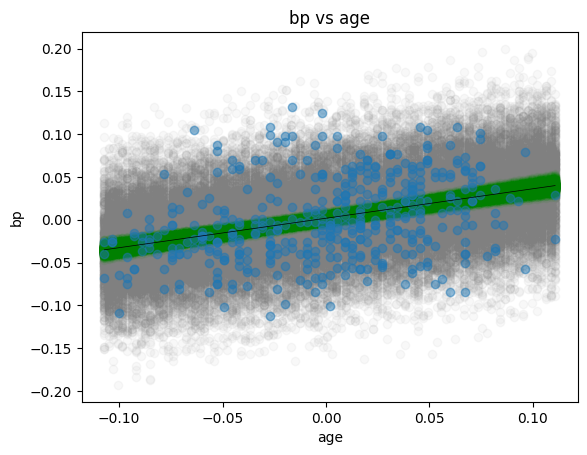

In [52]:
prediction_range = []
# sampling from the posterior to get a predictive interval
for x_ in x_range:
  prediction_range.append(post_samples[:500, 0] + post_samples[:500, 1] * x_)

prediction_range_noise = []

# sampling from the posterior to get a predictive interval
for x_ in x_range:
  prediction_range_noise.append(
    norm.rvs(post_samples[:500, 0] + post_samples[:500, 1] * x_, post_samples[:500, -1])
  )

# Plotting the uncertainty
for i, x_ in enumerate(x_range):
  plt.scatter(
    np.repeat(x_, 500) + diab["age"].mean(),
    prediction_range_noise[i],
    alpha=0.05,
    color="grey",
  )
for i, x_ in enumerate(x_range):
  plt.scatter(
    np.repeat(x_, 500) + diab["age"].mean(),
    prediction_range[i],
    alpha=0.05,
    color="green",
  )


plt.scatter(diab["age"], diab["bp"], alpha=0.5)
plt.plot(
  x_range + diab["age"].mean(), post_means[0] + post_means[1] * x_range, lw=0.5, color="black"
)
plt.title(f"bp vs age")
plt.ylabel("bp")
plt.xlabel("age")
plt.plot()


### Results
In our case, the quadratic model doesn't converge and gives very weird results. This makes the linear model better. I assume however that this is not the expected conclusion and this is probably due to a mistake in my code rather than a plausible explanation.